# Importing Necesary Packages

In [ ]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
import math

# Some Image Plotting Functions

In [ ]:
def plot_images(imgs, cmap='gray'):
    from matplotlib import gridspec
    fig = plt.figure(dpi=300, figsize=(10,10))
    gs = gridspec.GridSpec(1, len(imgs))
    for index, img in enumerate(imgs):
        ax = plt.subplot(gs[0, index])
        if(cmap == 'gray'):
            plt.imshow(img, cmap='gray')
        elif(cmap == 'rgb'):
            plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
        plt.xticks([]), plt.yticks([])
    plt.tight_layout()
    plt.show()

In [ ]:
gray = lambda img: cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# Part I: Augmented Reality with Planar Homographies

### 1.1 Getting Correspondences

A Function to detect feature points within the image using SIFT Descriptor which is invariant to Intensity, Scale, Orientation. </br>
- Input: Image Object.
- Outputs: Keypoints withing the image together with their descriptors.

In [ ]:
def detect_keypoints(img):
    sift = cv.SIFT_create()
    kp, des = sift.detectAndCompute(img,None) # None: means that no mask applied on the image
    return kp, des

A Function to draw the detected keypoints on the image. </br>
* Inputs: Image Object and its Keypoints.
* Output: Copy of the input image with keypoints detected on.

In [ ]:
def draw_keypoints(img, kp):
    return cv.drawKeypoints(img, kp, img)

Detecting and Drawing Keypoints of the 2 book images:
* Book Cover as a Template.
* Book on a desk as a test.

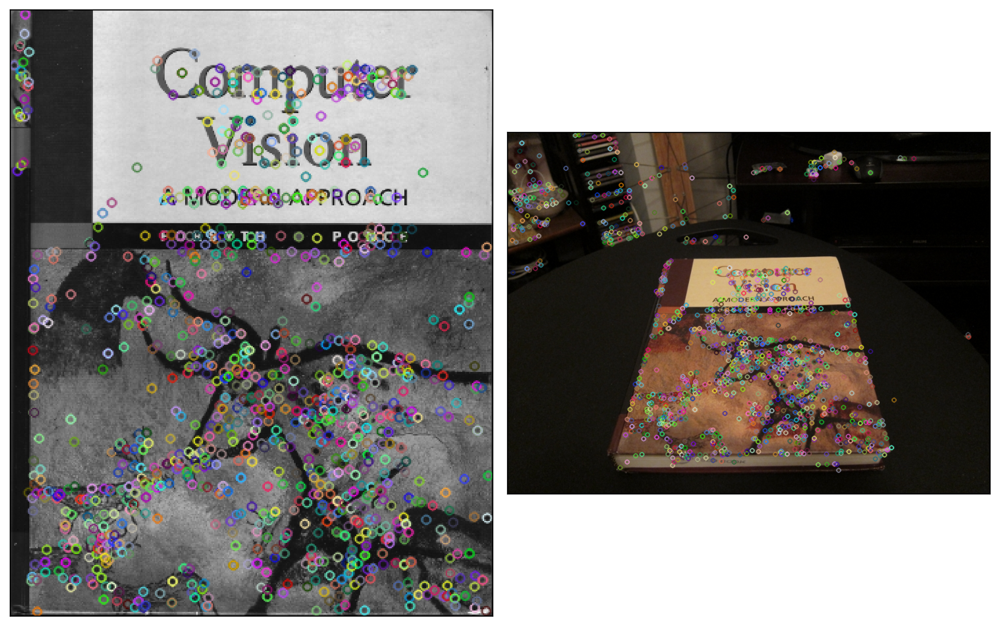

In [ ]:
cover = cv.imread('data/cv_cover.jpg', cv.IMREAD_GRAYSCALE)
desk_colored = cv.imread('data/cv_desk.png')
desk = gray(desk_colored)

cover_kp, cover_des = detect_keypoints(cover)
desk_kp, desk_des = detect_keypoints(desk)

# Show the keypoints of the cover image and the desk image
cover_img = draw_keypoints(cover, cover_kp)
desk_img = draw_keypoints(desk_colored.copy(), desk_kp)

plot_images([cover_img, desk_img], cmap='rgb')

a Function to match kepoints between 2 image descriptors using KNNMatch of the Bruteforce Matcher of opencv library.  

In [ ]:
def match_keypoints(des1, des2, k):
    bf = cv.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=k)
    return matches

a Function to apply ratio test between matches to choose non-ambiguous matches only according to some threshold (ratio).

In [ ]:
def ratio_test(matches, ratio):
    good = []
    for closest,second_closest in matches:
        if closest.distance < ratio*second_closest.distance:
            good.append(closest)
    return good

- Detecting the best 2 matches for every descriptor from image 1 in image 2.
- Applying Ratio Test to choose only non-ambiguous matches.


In [ ]:
matches = match_keypoints(cover_des, desk_des, 2)
good_matches = ratio_test(matches, 0.5)
print("Total matches: ", len(matches))
print("Good matches: ", len(good_matches))

Total matches:  1205
Good matches:  112


Sorting matches according to Distance between descriptors ascendingly. </br>
--> we will use this later select the best matches as correct ones to reveal the Homography Transformation parameters.

In [ ]:
sorted_matches = sorted(good_matches, key = lambda x:x.distance)

Drawing both images after detecting the best 50 matches (the first 50 matches of the sorted matches).

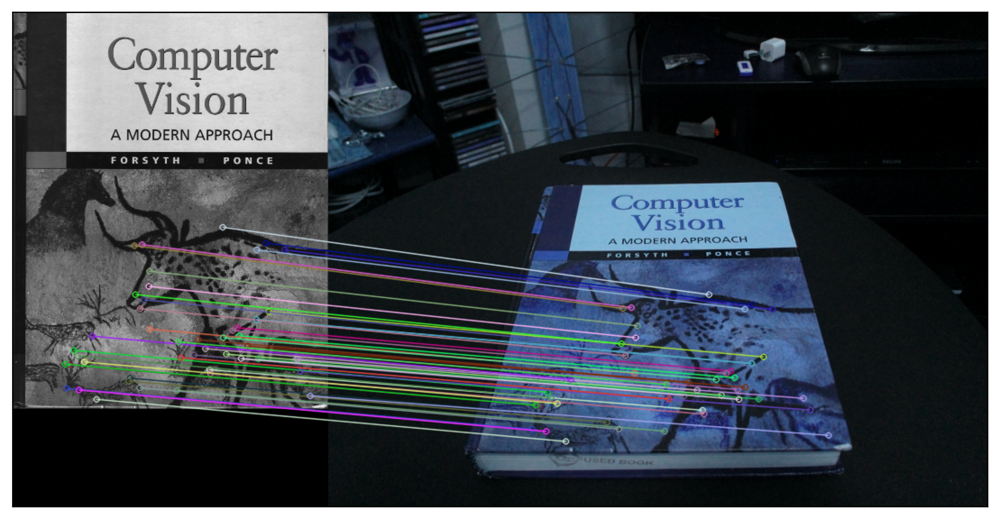

(<matplotlib.image.AxesImage at 0x26ad9a23be0>, None)

In [ ]:
fig = plt.figure(dpi=300, figsize=(10,10))
matched_img = cv.drawMatches(cover,cover_kp,desk_cousinlored,desk_kp,sorted_matches[:50],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,)
plt.xticks([]), plt.yticks([])
plt.imshow(matched_img),plt.show()

### 1.2 Compute the Homography Parameters

Getting source and destination feature points out of the sorted matches.

In [ ]:
src_pts = np.float32([cover_kp[m.queryIdx].pt for m in sorted_matches])
dst_pts = np.float32([desk_kp[m.trainIdx].pt for m in sorted_matches])

For the ith Match {(xᵢ, yᵢ) (x'ᵢ, y'ᵢ)}: </br>
* Create a 2 x 8 submatrix Aᵢ: Coefficients of the H matrix parameters used to compute x'ᵢ and y'ᵢ from xᵢ and yᵢ respectively.
* Create a 8 x 1 vector x: 8 Parameters of H matrix.
* Create a 2 x 1 vector bᵢ: [-x'ᵢ, -y'ᵢ]ᵀ





In [ ]:
_x = 0
_y = 1
match_to_matrices = lambda src, dst: (
    np.array([[-src[_x], -src[_y], -1, 0, 0, 0, src[_x]*dst[_x], src[_y]*dst[_x]], [0, 0, 0, -src[_x], -src[_y], -1, src[_x]*dst[_y], src[_y]*dst[_y]]]),
    np.array([-dst[_x], -dst[_y]])
    )

a Function to compute Homography Matrix using LSE Minimization. </br>
Note that the ninth parameter is set to 1.

In [ ]:
def compute_homography(src_pts, dst_pts):
    A = np.empty((0,8))
    B = np.empty((0,1))
    for i in range(src_pts.shape[0]):
        a, b = match_to_matrices(src_pts[i], dst_pts[i])
        A = np.append(A, a, axis=0)
        B = np.append(B, b)
    H_params = np.linalg.lstsq(A, B)[0]
    H_params = np.append(H_params, 1)
    H = H_params.reshape((3,3))
    return H

Computing the Homography Matrix for Book Images shown above.

In [ ]:
H = compute_homography(src_pts, dst_pts)
H

C:\Users\Dell\AppData\Local\Temp\ipykernel_10972\102375161.py:8: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  H_params = np.linalg.lstsq(A, B)[0]


array([[ 7.39278572e-01, -3.37324811e-01,  2.37421417e+02],
       [-1.76550585e-02,  2.34979890e-01,  1.92170096e+02],
       [-2.88452714e-05, -8.96620776e-04,  1.00000000e+00]])

Computing Pseudo-Inverse of the Homography Matrix as it may be a singular matrix.

In [ ]:
H_inv = np.linalg.pinv(H)
H_inv

array([[ 1.34693521e+00,  4.11563775e-01, -3.98881516e+02],
       [ 4.00553593e-02,  2.46753080e+00, -4.83695630e+02],
       [ 7.47671790e-05,  2.22431105e-03,  5.54802603e-01]])

In [ ]:
# Testing with a sheet example
test_src = np.array([[0,0], [0,1], [1,0], [1,1]])
test_dest = np.array([[0,0], [0.5,1], [2,0], [1.5,1]])
H_test = compute_homography(test_src, test_dest)
print(H_test)

[[ 2.00000000e+00  1.00000000e+00  1.38777878e-15]
 [-4.16333634e-16  2.00000000e+00 -3.60822483e-16]
 [-6.66133815e-16  1.00000000e+00  1.00000000e+00]]


C:\Users\Dell\AppData\Local\Temp\ipykernel_10972\102375161.py:8: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  H_params = np.linalg.lstsq(A, B)[0]


2 functions to convert a 2D point to the Homogenous Coordinates and vice verse respectively.

In [ ]:
homogenous = lambda p: np.array([p[0], p[1], 1])
dehomogenous = lambda p: np.array([p[0]/p[2], p[1]/p[2]])

a Function to get the Corresponding Point to a certain Point on applying forward warping

In [ ]:
get_corresponding_point = lambda p, H: dehomogenous(np.dot(H, homogenous(p)))

### Interactive Example

2 Functions to handle image clicks, the logic goes as follows:
* a circle is put around the clicked position of the image.
* the corresponding point to this point in the other image is computed using Forward warping.
* a circle is put around the Corresponding position in the other image.


In [ ]:
# Function to handle mouse clicks on the first image
def cover_click(event, x, y, flags, param):
    if event == cv.EVENT_LBUTTONDOWN:  # Check for left mouse button click
        print(f"Clicked on ({x}, {y})")
        cover_alt = cv.circle(cv.cvtColor(cover.copy(), cv.COLOR_GRAY2BGR), (x, y), 5, (0, 255, 0), 1)
        cv.imshow('Book Cover', cover_alt)
        point = np.array([x, y])
        point_transformed = get_corresponding_point(point, H)
        print(f"Mapped to {int(point_transformed[0])}, {int(point_transformed[1])}")
        desk_alt = cv.circle(desk_colored.copy(), (int(point_transformed[0]), int(point_transformed[1])), 5, (0, 255, 0), 1)
        cv.imshow('Desk', desk_alt)

def desk_click(event, x, y, flags, param):
    if event == cv.EVENT_LBUTTONDOWN:  # Check for left mouse button click
        print(f"Clicked on ({x}, {y})")
        desk_alt = cv.circle(desk_colored.copy(), (x, y), 5, (0, 255, 0), 1)
        cv.imshow('Desk', desk_alt)
        point = np.array([x, y])
        point_transformed = get_corresponding_point(point, H_inv)
        print(f"Mapped to {int(point_transformed[0])}, {int(point_transformed[1])}")
        cover_alt = cv.circle(cv.cvtColor(cover.copy(), cv.COLOR_GRAY2BGR), (int(point_transformed[0]), int(point_transformed[1])), 5, (0, 255, 0), 1)
        cv.imshow('Book Cover', cover_alt)


# Display the first image
cv.imshow('Book Cover', cover)

# Create a window for the second image
cv.imshow('Desk', desk_colored)

# Set mouse callback function for the first image window
cv.setMouseCallback('Book Cover', cover_click)

cv.setMouseCallback('Desk', desk_click)

# Wait for any key to be pressed and then close the windows
cv.waitKey(0)
cv.destroyAllWindows()

### 1.3 Calculate Book Coordinates

Computing the Corresponding Coordinates for the 4 corners of the book cover Template.

[[237.42141708 192.17009583]
 [146.986675   488.1381708 ]
 [584.06323289 486.03685732]
 [501.22924992 187.88771056]]


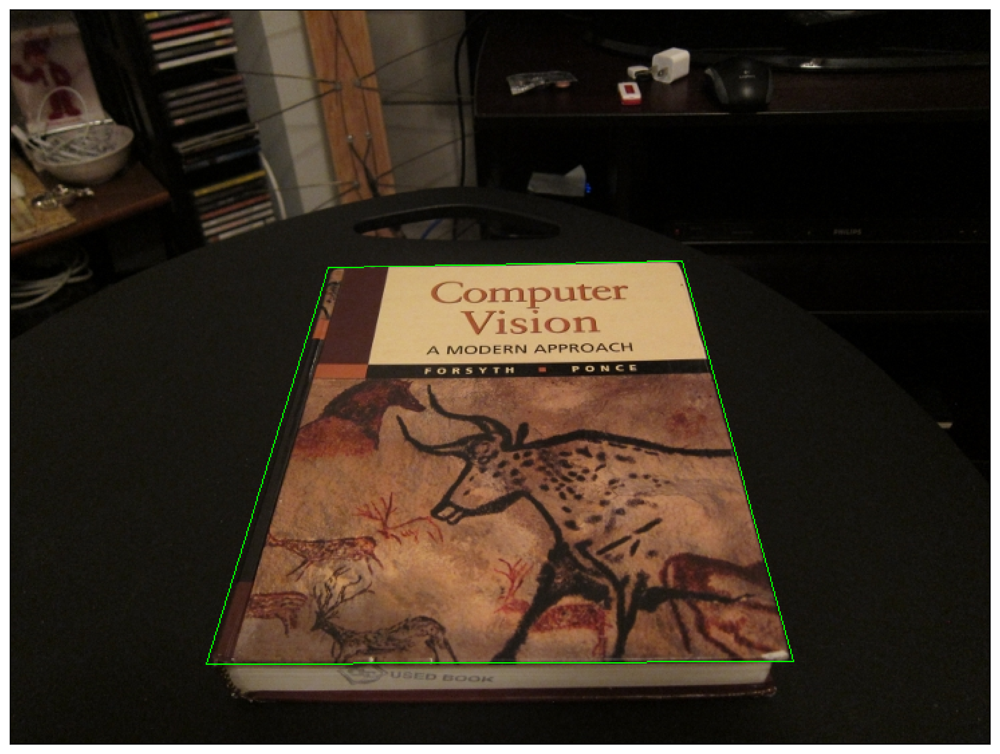

In [ ]:
## Get the corners of the cover image
cover_corners = np.array([
    homogenous([0,0]),
    homogenous([0, cover.shape[0]]),
    homogenous([cover.shape[1], cover.shape[0]]),
    homogenous([cover.shape[1], 0]),
])

## Get corresponding corners of the cover in the desk image
corresponding_corners = np.array([get_corresponding_point(p, H) for p in cover_corners])

print(corresponding_corners)

desk_with_cover_corners = cv.polylines(desk_colored.copy(), [np.int32(corresponding_corners)], 1, (0, 255, 0))

plot_images([desk_with_cover_corners], cmap='rgb')

### 1.4 Crop AR Video Frames

a Function to compute the aspect ratio of an image as a tuple.

In [ ]:
aspect_ratio = lambda p: (p[0]//np.gcd(p[0], p[1]), p[1]//np.gcd(p[0], p[1]))

a Function to do the following:
* Compute the modified Height and Width of an image based on some aspect ratio.
* Croping the Image evenly from both sides in terms of Height and Width to satisfy the modified dimensions.  

In [ ]:
def crop_aspect_ratio(img, ratio):
    print(f"Original dimensions {img.shape[:2]}")
    height, width = img.shape[:2]
    new_width = int(height*ratio[1]/ratio[0])
    new_height = int(width*ratio[0]/ratio[1])
    if new_width > width:
        new_width = width
    if new_height > height:
        new_height = height
    x = (width - new_width)//2
    y = (height - new_height)//2
    res = img[y:y+new_height, x:x+new_width]
    print(f"New dimensions {res.shape[:2]}")
    return res

In [ ]:
cover_aspect_ratio = aspect_ratio(cover.shape)
cropped_desk = crop_aspect_ratio(desk, cover_aspect_ratio)
print(f"Original aspect ratio: {cover_aspect_ratio[1]/cover_aspect_ratio[0]}")
print(f"New aspect ratio: {cropped_desk.shape[1]/cropped_desk.shape[0]}")

Original dimensions (548, 731)
New dimensions (548, 435)
Original aspect ratio: 0.7954545454545454
New aspect ratio: 0.7937956204379562


### Homography Class

a class for Homography Calculations:
* Constructor: does all the following: </br>
  1. Detecting and Matching feature points.
  2. Computing Homography Matrix and its Inverse.
  3. Computing the size of the destination image to warp the source image into.

* Transform Method: Computes a 2D image corresponding coordinate on applying forward warping.
* Transform Inverse Method: Computes a 2D image source coordinate on applying inverse warping.

* Warp Method: Warps an image using the specified output size and Homography Matrix.

* get_corners Method: Get the corresponding coordinates of the 4 corners of the book cover template as a source image in computing H matrix.

In [ ]:
class Homography:
    def __init__(self, src, dest, k=2, ratio=0.5):
        self.src_kp, self.src_des = detect_keypoints(src)
        self.dest_kp, self.dest_des = detect_keypoints(dest)
        self.matches = match_keypoints(self.src_des, self.dest_des, k)
        self.good_matches = ratio_test(self.matches, ratio)
        self.sorted_matches = sorted(self.good_matches, key = lambda x:x.distance)
        self.src_pts = np.float32([self.src_kp[m.queryIdx].pt for m in self.sorted_matches])
        self.dst_pts = np.float32([self.dest_kp[m.trainIdx].pt for m in self.sorted_matches])
        self.H = compute_homography(self.src_pts, self.dst_pts)
        self.H_inv = np.linalg.pinv(self.H)
        self.warp_size = (dest.shape[1], dest.shape[0])

    def transform(self, points):
        return np.array([np.round(get_corresponding_point(p, self.H)) for p in points]).astype(int)

    def transform_inverse(self, points):
        return np.array([get_corresponding_point(p, self.H_inv) for p in points])

    def warp(self, img):
        return cv.warpPerspective(img, self.H, self.warp_size)

    def get_corners(self, img):
        return self.transform(np.array([
            homogenous([0,0]),
            homogenous([0, img.shape[0]]),
            homogenous([img.shape[1], img.shape[0]]),
            homogenous([img.shape[1], 0]),
        ]))

### 1.5 Overlay the First Frame of the Two Videos

1. Read the first frame of both videos (ar video, book video).
2. Instantiating Homography class.
3. Getting corners of the book within the image.
4. cropping the first frame of the ar video according to the aspect ration of the book cover.
5. resizing the first frame of the ar video to fit the book cover.
6. warping ar video first frame into the first frame of the book video.
7. cropping the warped ar video frame to be within the book region in the book video frame.

C:\Users\Dell\AppData\Local\Temp\ipykernel_10972\102375161.py:8: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  H_params = np.linalg.lstsq(A, B)[0]


Original dimensions (720, 1280)
New dimensions (720, 572)


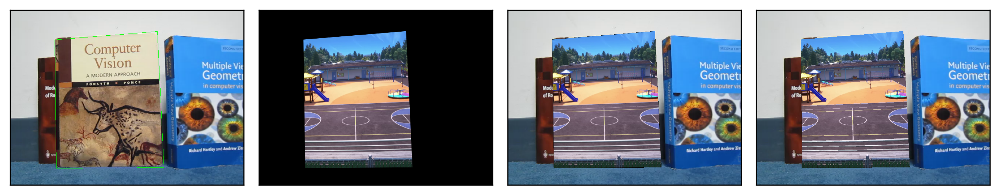

In [ ]:
src_video = cv.VideoCapture('data/ar_source.mov')
dst_video = cv.VideoCapture('data/book.mov')

src_ret, src_frame = src_video.read()
dst_read, dst_frame = dst_video.read()

homography = Homography(cover, gray(dst_frame.copy()))

dst_with_cover_corners = cv.polylines(dst_frame.copy(), [np.int32(homography.get_corners(cover.copy()))], 1, (0, 255, 0))

cropped_src = crop_aspect_ratio(src_frame, cover_aspect_ratio)
cropped_src = cv.resize(cropped_src, cover.shape[:2][::-1])

warpped_src = homography.warp(cropped_src)

warpped_merged_frame = dst_frame.copy()
for x in range(warpped_src.shape[1]):
    for y in range(warpped_src.shape[0]):
        if np.sum(warpped_src[y,x]) > 0:
            warpped_merged_frame[y,x] = warpped_src[y,x]

merged_frame = dst_frame.copy()
for y in range(cropped_src.shape[0]):
    for x in range(cropped_src.shape[1]):
        trans = homography.transform(np.array([[x,y]]))[0]
        if(trans[0] < merged_frame.shape[1] and trans[1] < merged_frame.shape[0]):
            merged_frame[trans[1],trans[0]] = cropped_src[y,x]

plot_images([dst_with_cover_corners, warpped_src, warpped_merged_frame, merged_frame], cmap='rgb')

### 1.6 Creating AR Application

In [ ]:
import time

Repeating the Logic of the above cell to all the frames of the both videos.

In [ ]:
fourcc = cv.VideoWriter_fourcc(*'XVID')
out = cv.VideoWriter(f'out/output-cover-{time.time()}.avi', fourcc, dst_video.get(cv.CAP_PROP_FPS), dst_frame.shape[:2][::-1])

while src_ret and dst_read:
    cropped_src = crop_aspect_ratio(src_frame, cover_aspect_ratio)
    cropped_src = cv.resize(cropped_src, cover.shape[:2][::-1])

    homography = Homography(cover, gray(dst_frame), ratio=0.35)

    merged_frame = dst_frame.copy()
    for y in range(cropped_src.shape[0]):
        for x in range(cropped_src.shape[1]):
            trans = homography.transform(np.array([[x,y]]))[0]
            if(trans[0] < merged_frame.shape[1] and trans[1] < merged_frame.shape[0] and trans[0] > 0 and trans[1]):
                merged_frame[trans[1],trans[0]] = cropped_src[y,x]

    out.write(merged_frame)

    src_ret, src_frame = src_video.read()
    dst_read, dst_frame = dst_video.read()

out.release()
src_video.release()
dst_video.release()

# Part II: Image Mosaics

### Reading the First Sample Images

Reading and Printing the 2 images to stitch

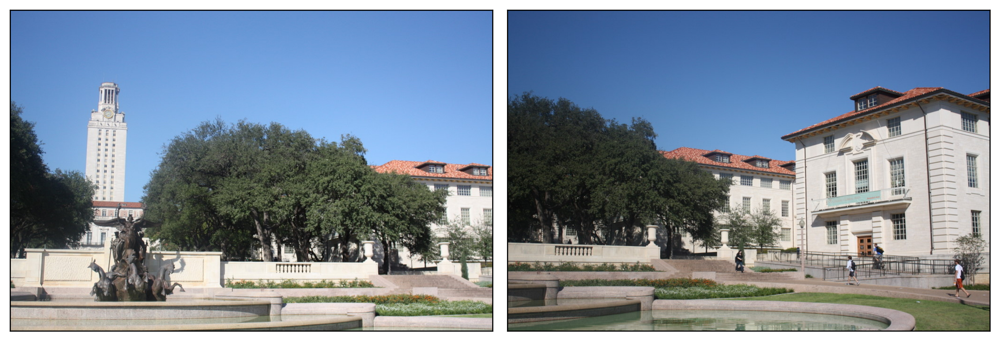

In [ ]:
sample_1_a = cv.imread('data/mosaic_sample_1_a.JPG')
sample_1_b = cv.imread('data/mosaic_sample_1_b.JPG')
plot_images([sample_1_a, sample_1_b], cmap = 'rgb')

### 2.1 Getting Correspondences and Compute the Homography Parameters

#### a) Computing Keypoints and Descriptors then Showing Keypoints of each image in the sample

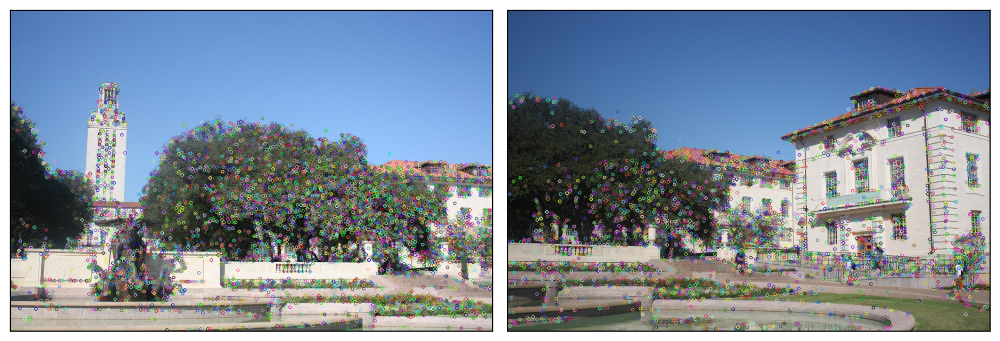

In [ ]:
# Calculating Keypoints and descriptors for each image in the sample
sample_1_a_kp, sample_1_a_des = detect_keypoints(sample_1_a)
sample_1_b_kp, sample_1_b_des = detect_keypoints(sample_1_b)

# Showing Keypoints on each image in the sampe
sample_1_a_with_kp = draw_keypoints(sample_1_a.copy(), sample_1_a_kp)
sample_1_b_with_kp = draw_keypoints(sample_1_b.copy(), sample_1_b_kp)
plot_images([sample_1_a_with_kp, sample_1_b_with_kp], cmap = 'rgb')

#### b) Computing the best matches between the 2 images

# Correspondencies: 5314
# Good Correspondencies: 724
Showing The Best 150 Correspondencies: 


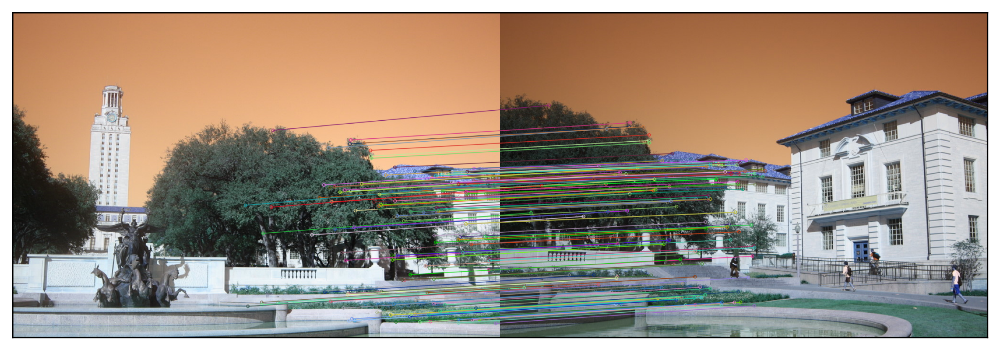

(<matplotlib.image.AxesImage at 0x26ae32530d0>, None)

In [ ]:
# Getting Best Correspondencies and Sorting them
correspondencies = match_keypoints(sample_1_a_des, sample_1_b_des, 2)
good_correspondencies = ratio_test(correspondencies, 0.5)
sorted_correspondencies = sorted(good_correspondencies, key = lambda x:x.distance)
print(f"# Correspondencies: {len(correspondencies)}")
print(f"# Good Correspondencies: {len(good_correspondencies)}")

# Showing the Best 100 Correspondencies
print("Showing The Best 150 Correspondencies: ")
fig = plt.figure(dpi=300, figsize=(10,10))
matched_image = cv.drawMatches(sample_1_a, sample_1_a_kp, sample_1_b, sample_1_b_kp, sorted_correspondencies[:150], None, flags=2)
plt.xticks([]), plt.yticks([])
plt.imshow(matched_image),plt.show()

### 2.2 Warping Between Image Planes

#### Getting the Selected KeyPoints, H matrix and its Pseudo-Inverse

using sorted Matches between the 2 images as described above to compute the H matrix from the second image to the first image.

In [ ]:
# Getting the Selected KeyPoints, H matrix and its Pseudo-Inverse
sample_1_a_selected_pts = np.float32([sample_1_a_kp[m.queryIdx].pt for m in sorted_correspondencies])
sample_1_b_selected_pts = np.float32([sample_1_b_kp[m.trainIdx].pt for m in sorted_correspondencies])
homography_matrix = compute_homography(sample_1_b_selected_pts, sample_1_a_selected_pts)
homography_matrix_inv = np.linalg.pinv(homography_matrix)

C:\Users\Dell\AppData\Local\Temp\ipykernel_10972\102375161.py:8: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  H_params = np.linalg.lstsq(A, B)[0]


#### a) Forward Warping

* Setting a default length for the output image.
* setting a Shift value to shift both input images in order to form a full stitched image

In [ ]:
dest_shape = (850, 1650, 3)
shift = 100

a Function to get the corresponding position in the previous image into the second image using forward warping.: </br>
1. Stacking the homogenous positions of the src_image as 3 x image shape matrix.
2. Multiplying the H matrix by the above matrix then getting the corresponding 2D coordinates in the other image.
3. Shifting is applied so that full images are displayed.
4. Mapped coordinates on pixel borders are rounded to the nearest pixel.

In [ ]:
def forward_warp(src_image, dest_shape, homography_matrix, shift_x=0, shift_y=0):
  destination = np.zeros(dest_shape, dtype=np.uint8)
  rows, cols, channels = src_image.shape
  homo_indices = np.array([homogenous([j, i]) for i in range(rows) for j in range(cols)])
  mapped_indices = np.matmul(homography_matrix, homo_indices.T).T
  homo_mapped_indices = np.array([dehomogenous(p) for p in mapped_indices])
  for i in range(len(homo_mapped_indices)):
    values = src_image[homo_indices[i, 1], homo_indices[i, 0]]
    x, y = round(homo_mapped_indices[i, 0]), round(homo_mapped_indices[i, 1])
    destination[shift_y + y, shift_x + x] = values
  return destination

* Forward Warping the second image.
* Copying the first image with shifting.

In [ ]:
output_image_holes = forward_warp(sample_1_b, dest_shape, homography_matrix, shift_y=shift)
output_image_holes[shift:fixed_b.shape[0]+shift, :fixed_b.shape[1], :] = sample_1_a

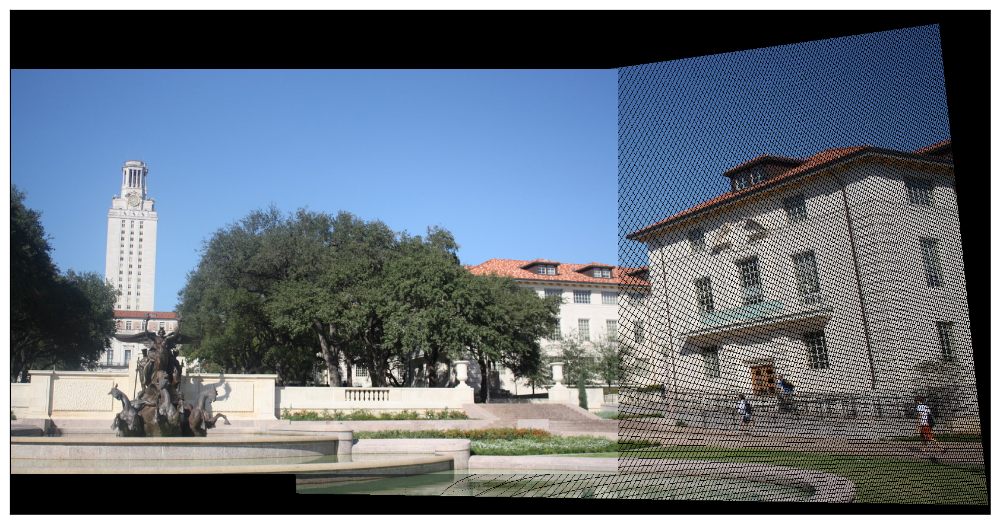

In [ ]:
plot_images([output_image_holes], cmap='rgb')

#### b) Backward Warping

1. Bilinear Interpolation Function: </br>
    a Function to resolve the problem of having the inverse coordinate on a pixel border using weighted average of the 4 surrounding corner pixels.
2. Inverse Warp: </br>
    * Multiplying inverse H matrix by each pixel position in the dest image channel to get the original pixel position before warping.
    * Calling the above Function to resolve the problem of having the inversly mapped coordinate on pixel border.  

In [ ]:
def bilinear_interpolation(img, x, y):
    x1, y1 = int(np.floor(x)), int(np.floor(y))
    x2, y2 = x1 + 1, y1 + 1

    if x1 < 0 or y1 < 0 or x2 >= img.shape[1] or y2 >= img.shape[0]:
        return 0  # Return 0 for out-of-bounds values

    q11, q21 = img[y1, x1], img[y1, x2]
    q12, q22 = img[y2, x1], img[y2, x2]

    # Bilinear interpolation formula
    value = (q11 * (x2 - x) * (y2 - y) +
             q21 * (x - x1) * (y2 - y) +
             q12 * (x2 - x) * (y - y1) +
             q22 * (x - x1) * (y - y1))

    return value

def inverse_warp(src_image_channel, destination_channel, homography_matrix, shift_x=0, shift_y=0):
    rows, cols = np.where(destination_channel == 0)
    inv_H = np.linalg.inv(homography_matrix)
    for y_out, x_out in list(zip(rows, cols)):
        # Calculate the inverse transformation
        x_in, y_in = dehomogenous(np.dot(inv_H, [x_out - shift_x, y_out - shift_y, 1]))
        # Bilinear interpolation
        destination_channel[y_out, x_out] = bilinear_interpolation(src_image_channel, x_in, y_in)

    return destination_channel

a Function to stitch 2 images together into a larger image of specified size:
1. Forwardly warping the second image into the first image as described above.
2. Applying inverse warping to each of the image channels.
3. Merging the recovered 3 channels after inverse warping.
4. Using a Mask to merge the first and the warped image without overwriting colored areas with black regions.

In [ ]:
def stitch_images(img_a, img_b, dest_shape, homography_matrix, shift_x=0, shift_y=0):
    destination = forward_warp(img_b, dest_shape, homography_matrix, shift_x, shift_y)
    d_b, d_g, d_r = cv.split(destination)
    b, g, r = cv.split(img_b)
    d_b = inverse_warp(b, d_b, homography_matrix, shift_x, shift_y)
    d_g = inverse_warp(g, d_g, homography_matrix, shift_x, shift_y)
    d_r = inverse_warp(r, d_r, homography_matrix, shift_x, shift_y)
    output_mosaic = cv.merge([d_b, d_g, d_r])
    mask = (img_a != 0)
    output_mosaic[shift_y:img_a.shape[0]+shift_y, shift_x:img_a.shape[1]+shift_x, :][mask] = img_a[mask]
    return output_mosaic

In [ ]:
output_image_without_holes = stitch_images(sample_1_a, sample_1_b, dest_shape, homography_matrix, shift_y=shift)

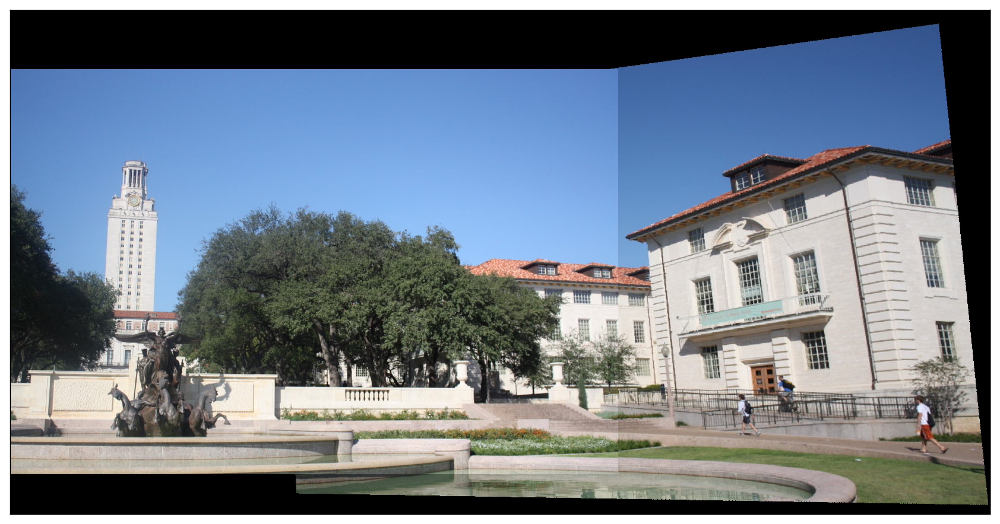

In [ ]:
plot_images([output_image_without_holes], cmap='rgb')

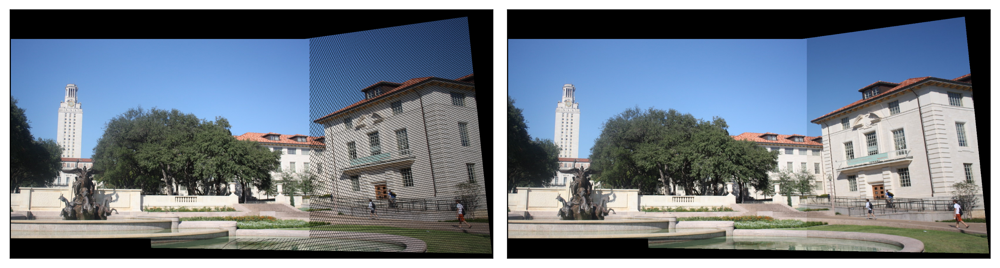

In [ ]:
plot_images([output_image_holes, output_image_without_holes], cmap='rgb')

# Part III (Bonus): Stitching 3 Images instead of 2

Loading the 3 specified images

In [ ]:
sample_a = cv.imread('data/shanghai-21.png')
sample_c = cv.imread('data/shanghai-22.png')
sample_b = cv.imread('data/shanghai-23.png')

a Function to show the best n matches between 2 images.

In [ ]:
def show_correspondences(img_src, img_dest, homo, no_matches=50):
    print("Showing The Best 50 Correspondencies: ")
    fig = plt.figure(dpi=300, figsize=(10,10))
    matched_image = cv.drawMatches(img_src, homo.src_kp, img_dest, homo.dest_kp, homo.sorted_matches[:no_matches], None, flags=2)
    plt.xticks([]), plt.yticks([])
    plt.imshow(matched_image),plt.show()

* Getting Homography Matrrix to transform image 2 to image 1.
* showing the correspondences between the two images.

C:\Users\Dell\AppData\Local\Temp\ipykernel_10972\102375161.py:8: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  H_params = np.linalg.lstsq(A, B)[0]


Showing The Best 50 Correspondencies: 


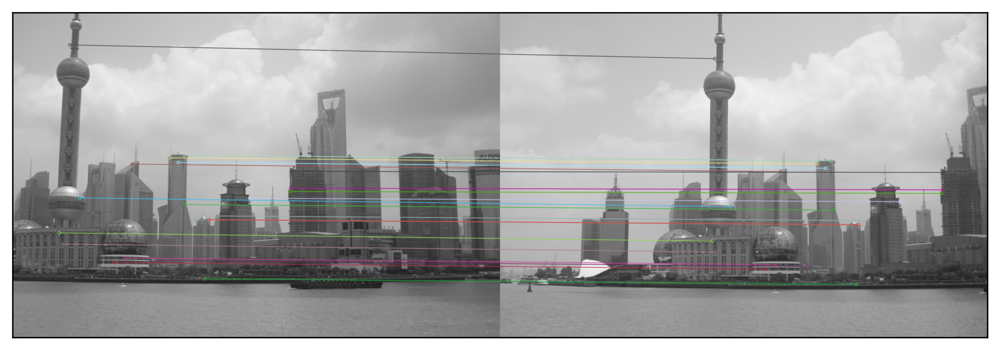

In [ ]:
homo = Homography(gray(sample_b), gray(sample_a))
show_correspondences(sample_b, sample_a, homo, 20)

stitching the above 2 images using the function described above.

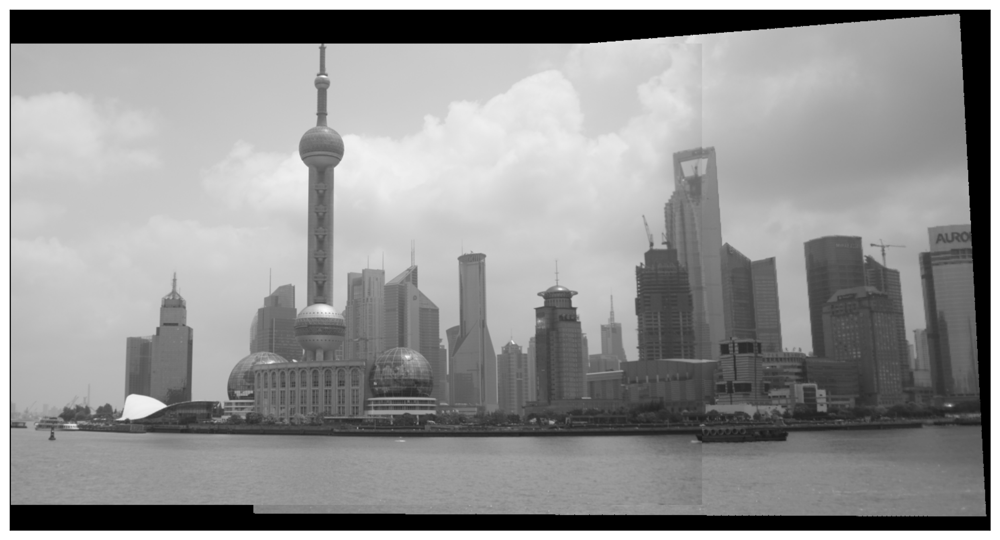

In [ ]:
stitched1 = stitch_images(sample_a, sample_b, (770, 1450, 3), homo.H, shift_y=50)
plot_images([stitched1], cmap='rgb')

* Getting Homography Matrrix to transform image 3 to the stitched image of the first two images .
* showing the correspondences between the two images.

C:\Users\Dell\AppData\Local\Temp\ipykernel_10972\102375161.py:8: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  H_params = np.linalg.lstsq(A, B)[0]


Showing The Best 50 Correspondencies: 


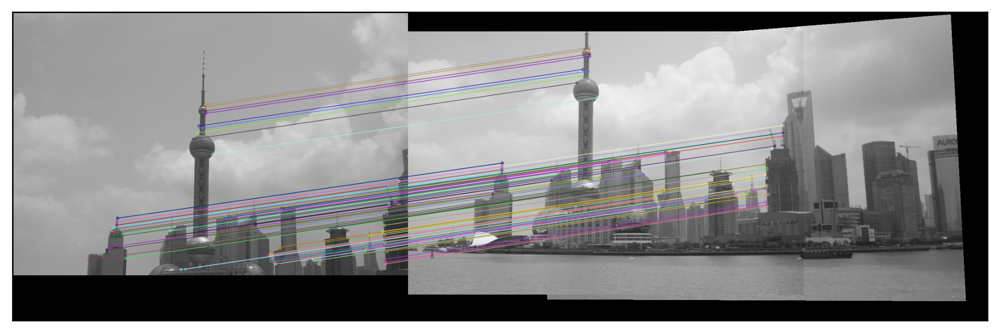

In [ ]:
homo2 = Homography(gray(sample_c), gray(stitched1))
show_correspondences(sample_c, stitched1, homo2, 100)

stitching the third image with the stitched image of the first two images using the function described above.

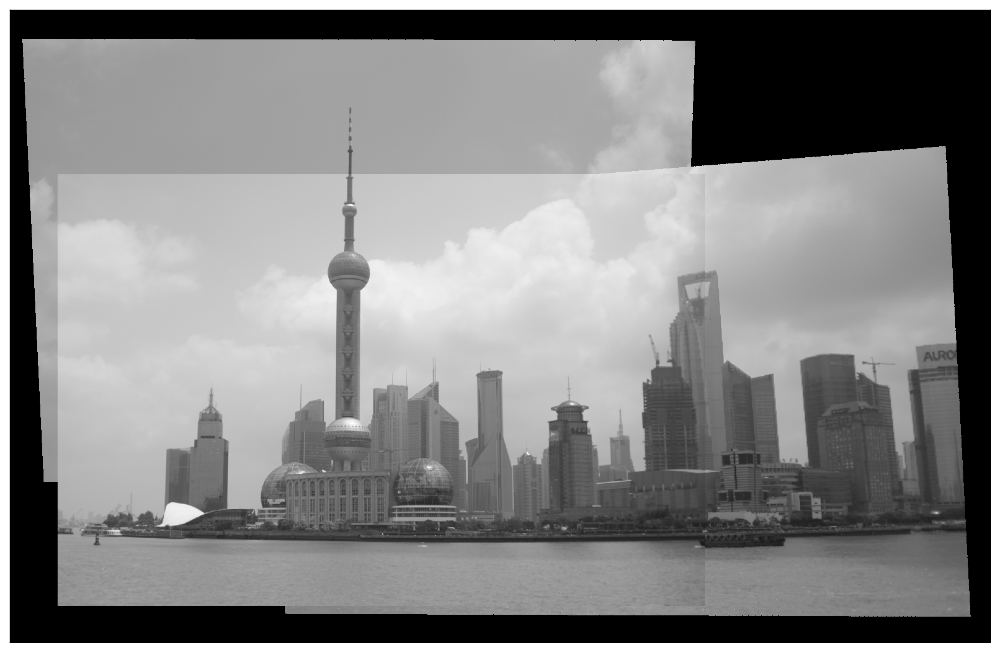

In [ ]:
stitched2 = stitch_images(stitched1, sample_c, (1000, 1550, 3), homo2.H, 75, 210)
plot_images([stitched2], cmap='rgb')